<a href="https://colab.research.google.com/github/AmritangshuM/unstructured_data_analytics/blob/main/Instagram%20Scraping%20and%20Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#!pip install --upgrade google-cloud-vision
#!pip install selenium
#Import Libraries
import numpy as np
import pandas as pd
import re
from time import sleep
from selenium import webdriver
from string import punctuation
import nltk
from nltk.tokenize import sent_tokenize, word_tokenize
from nltk.corpus import stopwords
import copy
import matplotlib.pyplot as plt
%pylab inline
from time import sleep
from selenium.webdriver.common.by import By
import nltk
from nltk import FreqDist
import warnings
warnings.filterwarnings("ignore")
from time import sleep
from selenium import webdriver
from selenium.webdriver.common.action_chains import ActionChains
from selenium.webdriver.common.keys import Keys
import time, urllib.request
import requests
from selenium.webdriver.chrome.options import Options
from selenium.webdriver.support.ui import WebDriverWait
from selenium.webdriver.common.by import By
from selenium.webdriver.support import expected_conditions as EC
#browser = webdriver.Chrome('/Users/amritangshumukherjee/Downloads/MIS 284N - Unstructured data/chromedriver')

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


/Users/amritangshumukherjee/opt/anaconda3/lib/python3.9/site-packages/IPython/core/magics/pylab.py:162: UserWarning: pylab import has clobbered these variables: ['copy']
`%matplotlib` prevents importing * from pylab and numpy
  warn("pylab import has clobbered these variables: %s"  % clobbered +


In [ ]:
from google.cloud import vision
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from google.cloud import storage
import argparse


import os
import io
from google.cloud import vision
from matplotlib import pyplot as plt
from matplotlib import patches as pch

os.environ['GOOGLE_APPLICATION_CREDENTIALS'] = os.path.join(os.curdir, '/Users/amritangshumukherjee/Downloads/MIS 284N - Unstructured data/Group Project/glassy-ripsaw-363816-450c4d9c456b.json')

In [ ]:
#----------------------------------Method 1------------------------------------------------------------
#!pip install instaloader
from instaloader import Instaloader, Profile
import instaloader
# Get instance
loader = instaloader.Instaloader()
# Login using the credentials
loader.login('amritangshumukherjee4', 'rocky0030')

dataframe = pd.DataFrame(columns = ['user','photo_description','likes_photo','comments_photo','time','image','image_labels','landmark_detection'])  

#pages=['muradosmann','jtype','theslowtraveler','thecommonwanderer','52perfectdays']
#pages=['katcarney','kylefrost','divergenttravelers','offthepath','alliemtaylor','greeny_nomad','rileys_travels','thebucketlistfamily','vancitywild','soultravelblog','thedharmatrails','lifeinminiaturepictures']
pages=['muradosmann','the_sleepy_voyager']

dataframe = pd.DataFrame(columns = ['user','bio','followed_by','follows','photo_description','photo_location','likes_photo','comments_photo','image','image_labels'])  

for user in pages:
    profile = instaloader.Profile.from_username(loader.context,user)
    media = profile.mediacount
    followers=profile.followers
    follows=profile.followees
    bio=profile.biography
    posts=profile.get_posts()
    count=0
    for post in posts:
        sleep(3)
        count=count+1
        if count>5:
            break
        if not post.is_video:
            image_uri=post.url
            client = vision.ImageAnnotatorClient()
            image = vision.Image()
            image.source.image_uri = image_uri

            response = client.label_detection(image=image)
            string=''
            for label in response.label_annotations:
                #print(label.description, '(%.2f%%)' % (label.score*100.))
                string=string+','+str(label.description)

            image_labels=string
            dataframe.loc[len(dataframe)] = [user,bio,followers,follows,post.caption,'',post.likes,post.comments,post.url,image_labels]
            #dataframe.to_csv('/Users/amritangshumukherjee/Downloads/MIS 284N - Unstructured data/Group Project/data_new_2.csv')
            #print(image_labels)
            #break
        
    
dataframe   

In [ ]:
#----------------------------------Method 2------------------------------------------------------------
browser = webdriver.Chrome('/Users/amritangshumukherjee/Downloads/MIS 284N - Unstructured data/chromedriver')
pages=['muradosmann','the_sleepy_voyager']
dataframe2 = pd.DataFrame(columns = ['user','photo_description','likes_photo','comments_photo','time','image','image_labels','landmark_detection'])  

for user in pages:
    browser.get('https://dumpor.com/v/'+user)
    sleep(5)
    
    user_details = browser.find_element(by=By.CLASS_NAME,value='user')
    stuff=user_details.find_elements(by=By.TAG_NAME,value='li')
    posts=stuff[0].text
    followers=stuff[1].text
    followed_by=stuff[2].text
    #print(posts,followers,followed_by)
    
    #scroll
    scrolldown = browser.execute_script("window.scrollTo(0, document.body.scrollHeight);var scrolldown=document.body.scrollHeight;return scrolldown;")
    match=False
    while(match==False):
        last_count = scrolldown
        sleep(8)
        scrolldown = browser.execute_script("window.scrollTo(0, document.body.scrollHeight);var scrolldown=document.body.scrollHeight;return scrolldown;")
        if last_count==scrolldown:
            match=True
    
    sleep(5)
    count=0   
    posts = browser.find_elements(by=By.CLASS_NAME,value='content__img-wrap')
    #print(len(posts))
    for post in posts:
        if count>5:
            break
        #print(post)
        comment = post.find_element(by=By.CLASS_NAME,value='content__text').text
        #print(comment)
        other_stuff = post.find_element(by=By.CLASS_NAME,value='content__btns')
        likes_stuff=other_stuff.find_elements(by=By.CLASS_NAME,value='flex-fill')
        likes=likes_stuff[0].text
        comments=likes_stuff[1].text
        time=likes_stuff[2].text
        #image=post.find_element(by=By.CLASS_NAME,value='content__btns')
        s1 = post.find_element(by=By.TAG_NAME,value='a')
        links = s1.find_element(by=By.TAG_NAME,value='img')
        image_link = links.get_attribute('src')

        #print(comment,likes,comments,time,image_link)

#------------images labels
        image_uri=image_link
        client = vision.ImageAnnotatorClient()
        image = vision.Image()
        image.source.image_uri = image_uri

        response = client.label_detection(image=image)
        string=''
        for label in response.label_annotations:
            #print(label.description, '(%.2f%%)' % (label.score*100.))
            string=string+','+str(label.description)

        image_labels=string

        #------------Landmark detection labels
        response2 = client.landmark_detection(image=image)

        string2=''
        for landmark in response2.landmark_annotations:
            #print(landmark.description)
            string2=string2+','+landmark.description

        landmark_detection=string2

        dataframe2.loc[len(dataframe2)] = [user,comment,likes,comments,time,image_link,image_labels,landmark_detection]

dataframe2

In [ ]:
dataframe3= pd.read_csv('/Users/amritangshumukherjee/Downloads/MIS 284N - Unstructured data/Group Project/instagram_data.csv')
#dataframe3= pd.read_csv('instagram_data.csv')
dataframe3=dataframe3.set_index('Unnamed: 0')
dataframe3

,user,bio,followed_by,follows,photo_description,photo_location,likes_photo,comments_photo,image,image_labels
Unnamed: 0,,,,,,,,,,
0,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,I was 6.5 months pregnant on my last winter ad...,NaN,357,16,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Snow,Sunglasses,Freezing,Slope,Eyewear,Geolog..."
1,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,Check out the full write up with a ton more ph...,NaN,522,21,https://scontent-dfw5-2.cdninstagram.com/v/t51...,",Water,Water resources,Snow,Natural landscape,..."
2,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,Yesterday we explored the Matanuska Glacier wi...,NaN,277,16,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Water,Slope,Snow,Terrain,Sports equipment,Rec..."
3,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,Flying in between the most intense and amazing...,NaN,846,29,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Cloud,Sky,Mountain,Snow,Slope,Glacial landfor..."
4,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,"It’s been 12 years since we’ve been to Alaska,...",NaN,309,14,https://scontent-dfw5-2.cdninstagram.com/v/t51...,",Mountain,Sky,Cloud,Window,Slope,House,Natural..."
...,...,...,...,...,...,...,...,...,...,...
8749,laurenepbath,🎤 Speaker 👩🏼‍💻 Coach 📸 Photographer \nAustrali...,383363,2424,Today started well and ended flat. Despite all...,NaN,561,35,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Cloud,Sky,Atmosphere,Afterglow,Orange,Dusk,Su..."
8750,laurenepbath,🎤 Speaker 👩🏼‍💻 Coach 📸 Photographer \nAustrali...,383363,2424,Do you want to know the one main practice I ha...,NaN,327,8,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Water,Water resources,Green,Plant,Natural lan..."
8751,laurenepbath,🎤 Speaker 👩🏼‍💻 Coach 📸 Photographer \nAustrali...,383363,2424,"This elephant is how I feel today, with some t...",NaN,570,19,https://scontent-dfw5-2.cdninstagram.com/v/t51...,",Cloud,Sky,Wood,People in nature,Fawn,Beak,Lan..."


In [ ]:
import copy
processing_1 = copy.deepcopy(dataframe3)

In [ ]:
#-----------------------------------------Data cleaning----------------------------------------------------
processing_1['photo_description']=processing_1['photo_description'].values.astype('str')
from string import punctuation
def punctuation_f(item):
    for p in punctuation:
        item = str(item).lstrip().replace(p,'')
    return item

def lower_f(x):
    return x.lower()

processing_1['comment_1'] = processing_1['photo_description'].apply(punctuation_f).apply(lower_f)


processing_1['comment_3'] = processing_1['comment_1'].apply(word_tokenize).apply(set).apply(list)

stop_words = set(stopwords.words('english'))
def r_stopwords(s):
    return [w for w in s if not w in stop_words] 
    
processing_1['final'] =  processing_1['comment_3'].apply(r_stopwords)

processing_1['image_labels']=processing_1['image_labels'].values.astype('str')
#processing_1['image_labels'] = processing_1['image_labels'].apply(punctuation_f).apply(lower_f)
processing_1['image_labels_token'] = processing_1['image_labels'].apply(word_tokenize).apply(set).apply(list)
processing_1['image_labels_token_final'] =  processing_1['image_labels_token'].apply(r_stopwords)

In [ ]:
#pip install vaderSentiment
import nltk
nltk.download('vader_lexicon')
from nltk.sentiment.vader import SentimentIntensityAnalyzer
sid = SentimentIntensityAnalyzer()

#newWords = {'light': 2.0, 'carbonation': 2.0, 'malt': 2.0}
#sid.lexicon.update(newWords)
processing_1['vader_scores'] = processing_1['photo_description'].apply(lambda review: sid.polarity_scores(review))
processing_1['vader_compound']  = processing_1['vader_scores'].apply(lambda score_dict: score_dict['compound'])
processing_1['vader_comp_score'] = processing_1['vader_compound'].apply(lambda c: 'pos' if c >=0.05 else 'neg')

processing_1

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /Users/amritangshumukherjee/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


,user,bio,followed_by,follows,photo_description,photo_location,likes_photo,comments_photo,image,image_labels,comment_1,comment_3,final,image_labels_token,image_labels_token_final,vader_scores,vader_compound,vader_comp_score
Unnamed: 0,,,,,,,,,,,,,,,,,,
0,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,I was 6.5 months pregnant on my last winter ad...,NaN,357,16,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Snow,Sunglasses,Freezing,Slope,Eyewear,Geolog...",i was 65 months pregnant on my last winter adv...,"[thankful, was, move, be, seems, portion, comf...","[thankful, move, seems, portion, comfort, 8, m...","[,, Snow, phenomenon, Freezing, Eyewear, cap, ...","[,, Snow, phenomenon, Freezing, Eyewear, cap, ...","{'neg': 0.05, 'neu': 0.667, 'pos': 0.283, 'com...",0.9876,pos
1,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,Check out the full write up with a ton more ph...,NaN,522,21,https://scontent-dfw5-2.cdninstagram.com/v/t51...,",Water,Water resources,Snow,Natural landscape,...",check out the full write up with a ton more ph...,"[recent, ice, made, most, link, alaska, up, cr...","[recent, ice, made, link, alaska, craigasaurus...","[Lake, landscape, ,, Snow, ice, Freezing, Pola...","[Lake, landscape, ,, Snow, ice, Freezing, Pola...","{'neg': 0.0, 'neu': 0.948, 'pos': 0.052, 'comp...",0.3774,pos
2,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,Yesterday we explored the Matanuska Glacier wi...,NaN,277,16,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Water,Slope,Snow,Terrain,Sports equipment,Rec...",yesterday we explored the matanuska glacier wi...,"[matanuska, ’, re, their, much, because, we, i...","[matanuska, ’, much, ice, us, big, consider, b...","[equipment, Terrain, ,, Snow, phenomenon, Spor...","[equipment, Terrain, ,, Snow, phenomenon, Spor...","{'neg': 0.0, 'neu': 0.851, 'pos': 0.149, 'comp...",0.9041,pos
3,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,Flying in between the most intense and amazing...,NaN,846,29,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Cloud,Sky,Mountain,Snow,Slope,Glacial landfor...",flying in between the most intense and amazing...,"[ve, ’, peaks, but, ever, land, recommend, we,...","[’, peaks, ever, land, recommend, alaska, else...","[Tree, Travel, ,, Snow, Landscape, Mountain, G...","[Tree, Travel, ,, Snow, Landscape, Mountain, G...","{'neg': 0.042, 'neu': 0.845, 'pos': 0.113, 'co...",0.4262,pos
4,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,"It’s been 12 years since we’ve been to Alaska,...",NaN,309,14,https://scontent-dfw5-2.cdninstagram.com/v/t51...,",Mountain,Sky,Cloud,Window,Slope,House,Natural...",it’s been 12 years since we’ve been to alaska ...,"[while, years, ve, we, come, most, been, place...","[years, come, place, covid, taken, ”, views, g...","[Fog, landscape, Natural, House, Wood, ,, Moun...","[Fog, landscape, Natural, House, Wood, ,, Moun...","{'neg': 0.022, 'neu': 0.828, 'pos': 0.15, 'com...",0.9558,pos
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8749,laurenepbath,🎤 Speaker 👩🏼‍💻 Coach 📸 Photographer \nAustrali...,383363,2424,Today started well and ended flat. Despite all...,NaN,561,35,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Cloud,Sky,Atmosphere,Afterglow,Orange,Dusk,Su...",today started well and ended flat despite all ...,"[other, today, dropped, ve, scrolling, notice,...","[today, dropped, scrolling, notice, much, suns...","[at, Red, sky, ,, Atmosphere, Afterglow, Dusk,...","[Red, sky, ,, Atmosphere, Afterglow, Dusk, Sun...","{'neg': 0.119, 'neu': 0.791, 'pos': 0.09, 'com...",-0.8151,neg
8750,laurenepbath,🎤 Speaker 👩🏼‍💻 Coach 📸 Photographer \nAustrali...,383363,2424,Do you want to know the one main practice I ha...,NaN,327,8,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Water,Water resources,Green,Plant,Natural lan...",do you want to know the one main practice i ha...,"[at, years, lauren, we, fr

  0%|                                                  | 0/2178 [00:00<?, ?it/s]


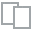
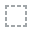
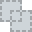
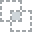
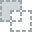
...
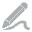
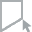
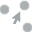
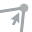
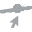

In [ ]:
#!pip install dataprep

#processing_1=processing_1.drop(['photo_location'], axis=1)
from dataprep.eda import create_report
create_report(processing_1).show()

LDA - sub topics with diagram - Amrit

Secret sauce - Instagram, hashtags, key words, key items in image, regression - Prat, Anush, Viv
    Comparison of Jtype vs muradosman, similarity, sentiment, common words 

Recommendation system - common attributes - More data 5k - Aish

# ----------------------------------LDA------------------------------------------------------------------------

In [ ]:
processing_1

,user,bio,followed_by,follows,photo_description,photo_location,likes_photo,comments_photo,image,image_labels,comment_1,comment_3,final,image_labels_token,image_labels_token_final,vader_scores,vader_compound,vader_comp_score
Unnamed: 0,,,,,,,,,,,,,,,,,,
0,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,I was 6.5 months pregnant on my last winter ad...,NaN,357,16,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Snow,Sunglasses,Freezing,Slope,Eyewear,Geolog...",i was 65 months pregnant on my last winter adv...,"['thankful', 'was', 'move', 'be', 'seems', 'po...","['thankful', 'move', 'seems', 'portion', 'comf...","[',', 'Snow', 'phenomenon', 'Freezing', 'Eyewe...","[',', 'Snow', 'phenomenon', 'Freezing', 'Eyewe...","{'neg': 0.05, 'neu': 0.667, 'pos': 0.283, 'com...",0.9876,pos
1,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,Check out the full write up with a ton more ph...,NaN,522,21,https://scontent-dfw5-2.cdninstagram.com/v/t51...,",Water,Water resources,Snow,Natural landscape,...",check out the full write up with a ton more ph...,"['recent', 'ice', 'made', 'most', 'link', 'ala...","['recent', 'ice', 'made', 'link', 'alaska', 'c...","['Lake', 'landscape', ',', 'Snow', 'ice', 'Fre...","['Lake', 'landscape', ',', 'Snow', 'ice', 'Fre...","{'neg': 0.0, 'neu': 0.948, 'pos': 0.052, 'comp...",0.3774,pos
2,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,Yesterday we explored the Matanuska Glacier wi...,NaN,277,16,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Water,Slope,Snow,Terrain,Sports equipment,Rec...",yesterday we explored the matanuska glacier wi...,"['matanuska', '’', 're', 'their', 'much', 'bec...","['matanuska', '’', 'much', 'ice', 'us', 'big',...","['equipment', 'Terrain', ',', 'Snow', 'phenome...","['equipment', 'Terrain', ',', 'Snow', 'phenome...","{'neg': 0.0, 'neu': 0.851, 'pos': 0.149, 'comp...",0.9041,pos
3,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,Flying in between the most intense and amazing...,NaN,846,29,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Cloud,Sky,Mountain,Snow,Slope,Glacial landfor...",flying in between the most intense and amazing...,"['ve', '’', 'peaks', 'but', 'ever', 'land', 'r...","['’', 'peaks', 'ever', 'land', 'recommend', 'a...","['Tree', 'Travel', ',', 'Snow', 'Landscape', '...","['Tree', 'Travel', ',', 'Snow', 'Landscape', '...","{'neg': 0.042, 'neu': 0.845, 'pos': 0.113, 'co...",0.4262,pos
4,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,"It’s been 12 years since we’ve been to Alaska,...",NaN,309,14,https://scontent-dfw5-2.cdninstagram.com/v/t51...,",Mountain,Sky,Cloud,Window,Slope,House,Natural...",it’s been 12 years since we’ve been to alaska ...,"['while', 'years', 've', 'we', 'come', 'most',...","['years', 'come', 'place', 'covid', 'taken', '...","['Fog', 'landscape', 'Natural', 'House', 'Wood...","['Fog', 'landscape', 'Natural', 'House', 'Wood...","{'neg': 0.022, 'neu': 0.828, 'pos': 0.15, 'com...",0.9558,pos
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8749,laurenepbath,🎤 Speaker 👩🏼‍💻 Coach 📸 Photographer \nAustrali...,383363,2424,Today started well and ended flat. Despite all...,NaN,561,35,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Cloud,Sky,Atmosphere,Afterglow,Orange,Dusk,Su...",today started well and ended flat despite all ...,"[other, today, dropped, ve, scrolling, notice,...","[today, dropped, scrolling, notice, much, suns...","[at, Red, sky, ,, Atmosphere, Afterglow, Dusk,...","[Red, sky, ,, Atmosphere, Afterglow, Dusk, Sun...","{'neg': 0.119, 'neu': 0.791, 'pos': 0.09, 'com...",-0.8151,neg
8750,laurenepbath,🎤 Speaker 👩🏼‍💻 Coach 📸 Photographer \nAustrali...,383363,2424,Do you want to know the one main practice I ha...,NaN,327,8,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Water,Water resources,Green,Plant,Natural lan...",do you want to know the one main practice i ha...,"[at, years, lauren, we, fr

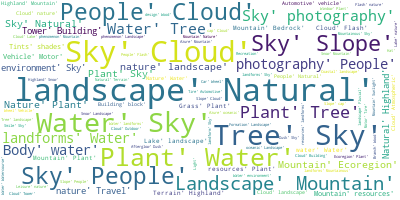

In [ ]:
# Import the wordcloud library
from wordcloud import WordCloud
# Join the different processed titles together.
#processing_1['final']=processing_1['final']
long_string = ','.join(list(map(str, processing_1['image_labels_token_final'].values)))
# Create a WordCloud object
wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue')
# Generate a word cloud
wordcloud.generate(long_string)
# Visualize the word cloud
wordcloud.to_image()

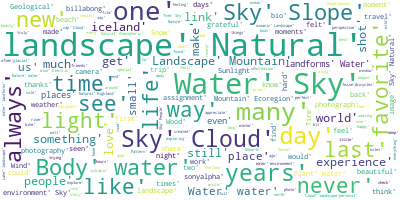

In [ ]:
processing_6=processing_1[processing_1['user']=='chrisburkard']

# Import the wordcloud library
from wordcloud import WordCloud
# Join the different processed titles together.
#processing_1['final']=processing_1['final']
long_string1 = ','.join(list(map(str, processing_6['image_labels_token_final'].values)))
long_string2 = ','.join(list(map(str, processing_6['final'].values)))
long_string=long_string1+long_string2
# Create a WordCloud object
wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue')
# Generate a word cloud
wordcloud.generate(long_string)
# Visualize the word cloud
wordcloud.to_image()

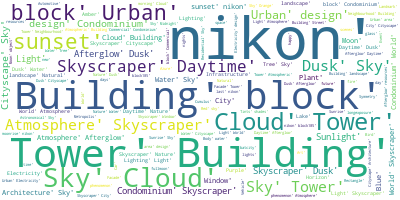

In [ ]:
processing_6=processing_1[processing_1['user']=='jtype']

# Import the wordcloud library
from wordcloud import WordCloud
# Join the different processed titles together.
#processing_1['final']=processing_1['final']
long_string1 = ','.join(list(map(str, processing_6['image_labels_token_final'].values)))
long_string2 = ','.join(list(map(str, processing_6['final'].values)))
long_string=long_string1+long_string2
# Create a WordCloud object
wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue')
# Generate a word cloud
wordcloud.generate(long_string)
# Visualize the word cloud
wordcloud.to_image()

In [ ]:
import numpy as np
import pandas as pd
import re, nltk, spacy, gensim
from sklearn.decomposition import LatentDirichletAllocation, TruncatedSVD
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.model_selection import GridSearchCV
from pprint import pprint
# Convert to list
components=3
import copy
processing_2 = copy.deepcopy(dataframe3)
data_processing = processing_1.final.values.tolist()

def sent_to_words(sentences):
    for sentence in sentences:
        yield(gensim.utils.simple_preprocess(str(sentence), deacc=True))  # deacc=True removes punctuations
        
def lemmatization(texts, allowed_postags=['NOUN', 'VERB']):
    texts_out = []
    for sent in texts:
        doc = nlp(" ".join(sent)) 
        texts_out.append(" ".join([token.lemma_ if token.lemma_ not in ['-PRON-'] else '' for token in doc if token.pos_ in allowed_postags]))
    return texts_out

data_items= list(sent_to_words(data_processing))

nlp = spacy.load('en_core_web_md') 
lemmatized = lemmatization(data_items) #select noun and verb

vectorizer = CountVectorizer(analyzer='word', min_df=components,stop_words='english', lowercase=False) 
data_vectorized = vectorizer.fit_transform(lemmatized)

# Build LDA Model

num_topics = 3
# Build LDA model

lda_model = LatentDirichletAllocation(n_components=components,max_iter=10,learning_method='online')
lda_output = lda_model.fit_transform(data_vectorized)
print(lda_model)  # Model attributes

LatentDirichletAllocation(learning_method='online', n_components=3)


In [ ]:
# Show top n keywords for each topic
def show_topics(vectorizer=vectorizer, lda_model=lda_model, n_words=components):
    keywords = np.array(vectorizer.get_feature_names_out())
    topic_keywords = []
    for topic_weights in lda_model.components_:
        top_keyword_locs = (-topic_weights).argsort()[:n_words]
        topic_keywords.append(keywords.take(top_keyword_locs))
    return topic_keywords
topic_keywords = show_topics(vectorizer=vectorizer, lda_model=lda_model, n_words=10)

# Topic - Keywords Dataframe
df_topic_keywords = pd.DataFrame(topic_keywords)
df_topic_keywords.columns = ['Word '+str(i) for i in range(df_topic_keywords.shape[1])]
df_topic_keywords.index = ['Topic '+str(i) for i in range(df_topic_keywords.shape[0])]
df_topic_keywords

,Word 0,Word 1,Word 2,Word 3,Word 4,Word 5,Word 6,Word 7,Word 8,Word 9
Topic 0,make,travel,know,feel,year,time,link,life,love,thing
Topic 1,day,time,photo,place,trip,make,look,year,feel,love
Topic 2,sand,winter,snow,color,mountain,visit,die,fall,tree,light


In [ ]:
# Define function to predict topic for a given text document.
nlp = spacy.load('en_core_web_md')
topic_names = pd.DataFrame(columns = ['topic','name'])      

def predict_topic(text, nlp=nlp):
    global sent_to_words
    global lemmatization
    text_2 = list(sent_to_words(text))
    text_3 = lemmatization(text_2, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV'])
    text_4 = vectorizer.transform(text_3)
    topic_probability_scores = lda_model.transform(text_4)
    topic = df_topic_keywords.iloc[np.argmax(topic_probability_scores), 1:14].values.tolist()
    # Infer Topic
    infer_topic = df_topic_keywords.iloc[np.argmax(topic_probability_scores), 0]
    topic_names.loc[len(topic_names)] = [np.argmax(topic_probability_scores),infer_topic]
    return infer_topic, topic, topic_probability_scores

def apply_predict_topic(text):
    text = [text]
    infer_topic, topic, prob_scores = predict_topic(text = text)
    return(infer_topic)

processing_1["Topic_key"]= processing_1['photo_description'].apply(apply_predict_topic)
processing_1




,user,bio,followed_by,follows,photo_description,photo_location,likes_photo,comments_photo,image,image_labels,comment_1,comment_3,final,image_labels_token,image_labels_token_final,vader_scores,vader_compound,vader_comp_score,Topic_key
Unnamed: 0,,,,,,,,,,,,,,,,,,,
0,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,I was 6.5 months pregnant on my last winter ad...,NaN,357,16,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Snow,Sunglasses,Freezing,Slope,Eyewear,Geolog...",i was 65 months pregnant on my last winter adv...,"['thankful', 'was', 'move', 'be', 'seems', 'po...","['thankful', 'move', 'seems', 'portion', 'comf...","[',', 'Snow', 'phenomenon', 'Freezing', 'Eyewe...","[',', 'Snow', 'phenomenon', 'Freezing', 'Eyewe...","{'neg': 0.05, 'neu': 0.667, 'pos': 0.283, 'com...",0.9876,pos,day
1,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,Check out the full write up with a ton more ph...,NaN,522,21,https://scontent-dfw5-2.cdninstagram.com/v/t51...,",Water,Water resources,Snow,Natural landscape,...",check out the full write up with a ton more ph...,"['recent', 'ice', 'made', 'most', 'link', 'ala...","['recent', 'ice', 'made', 'link', 'alaska', 'c...","['Lake', 'landscape', ',', 'Snow', 'ice', 'Fre...","['Lake', 'landscape', ',', 'Snow', 'ice', 'Fre...","{'neg': 0.0, 'neu': 0.948, 'pos': 0.052, 'comp...",0.3774,pos,day
2,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,Yesterday we explored the Matanuska Glacier wi...,NaN,277,16,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Water,Slope,Snow,Terrain,Sports equipment,Rec...",yesterday we explored the matanuska glacier wi...,"['matanuska', '’', 're', 'their', 'much', 'bec...","['matanuska', '’', 'much', 'ice', 'us', 'big',...","['equipment', 'Terrain', ',', 'Snow', 'phenome...","['equipment', 'Terrain', ',', 'Snow', 'phenome...","{'neg': 0.0, 'neu': 0.851, 'pos': 0.149, 'comp...",0.9041,pos,day
3,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,Flying in between the most intense and amazing...,NaN,846,29,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Cloud,Sky,Mountain,Snow,Slope,Glacial landfor...",flying in between the most intense and amazing...,"['ve', '’', 'peaks', 'but', 'ever', 'land', 'r...","['’', 'peaks', 'ever', 'land', 'recommend', 'a...","['Tree', 'Travel', ',', 'Snow', 'Landscape', '...","['Tree', 'Travel', ',', 'Snow', 'Landscape', '...","{'neg': 0.042, 'neu': 0.845, 'pos': 0.113, 'co...",0.4262,pos,day
4,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,"It’s been 12 years since we’ve been to Alaska,...",NaN,309,14,https://scontent-dfw5-2.cdninstagram.com/v/t51...,",Mountain,Sky,Cloud,Window,Slope,House,Natural...",it’s been 12 years since we’ve been to alaska ...,"['while', 'years', 've', 'we', 'come', 'most',...","['years', 'come', 'place', 'covid', 'taken', '...","['Fog', 'landscape', 'Natural', 'House', 'Wood...","['Fog', 'landscape', 'Natural', 'House', 'Wood...","{'neg': 0.022, 'neu': 0.828, 'pos': 0.15, 'com...",0.9558,pos,day
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8749,laurenepbath,🎤 Speaker 👩🏼‍💻 Coach 📸 Photographer \nAustrali...,383363,2424,Today started well and ended flat. Despite all...,NaN,561,35,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Cloud,Sky,Atmosphere,Afterglow,Orange,Dusk,Su...",today started well and ended flat despite all ...,"[other, today, dropped, ve, scrolling, notice,...","[today, dropped, scrolling, notice, much, suns...","[at, Red, sky, ,, Atmosphere, Afterglow, Dusk,...","[Red, sky, ,, Atmosphere, Afterglow, Dusk, Sun...","{'neg': 0.119, 'neu': 0.791, 'pos': 0.09, 'com...",-0.8151,neg,make
8750,laurenepbath,🎤 Speaker 👩🏼‍💻 Coach 📸 Photographer \nAustrali...,383363,2424,Do you want to know the one main practice I ha...,NaN,327,8,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Water,Water resources,Green,Plant,Natural lan...",do you want to know the one main prac

In [ ]:
processing_1['Topic_key'] = processing_1['Topic_key'].str.replace('day', 'Time of Year')
processing_1['Topic_key'] = processing_1['Topic_key'].str.replace('make', 'Experience')
processing_1['Topic_key'] = processing_1['Topic_key'].str.replace('ichosetowander', 'Landscape')

In [ ]:
import warnings
warnings.simplefilter("ignore", category=PendingDeprecationWarning)

print('topic names:\n',topic_names.drop_duplicates())
from __future__ import print_function
import pyLDAvis
import pyLDAvis.sklearn
pyLDAvis.enable_notebook()

pyLDAvis.sklearn.prepare(lda_model, data_vectorized, vectorizer)

topic names:
     topic  name
0       1   day
5       0  make
17      2  sand


/Users/amritangshumukherjee/opt/anaconda3/lib/python3.9/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/Users/amritangshumukherjee/opt/anaconda3/lib/python3.9/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/Users/amritangshumukherjee/opt/anaconda3/lib/python3.9/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/Users/amritangshumukherjee/opt/anaconda3/lib/python3.9/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/Users/amritangs

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
0     -0.156872  0.128866       1        1  45.360664
1     -0.107116 -0.146144       2        1  42.402646
2      0.263987  0.017278       3        1  12.236690, topic_info=           Term         Freq        Total Category  logprob  loglift
2978   mountain   554.000000   554.000000  Default  30.0000  30.0000
1177        day  1773.000000  1773.000000  Default  29.0000  29.0000
2683       link   597.000000   597.000000  Default  28.0000  28.0000
1692       fall   410.000000   410.000000  Default  27.0000  27.0000
5234     winter   257.000000   257.000000  Default  26.0000  26.0000
...         ...          ...          ...      ...      ...      ...
5241       wish    81.532933   148.795359   Topic3  -5.4947   1.4992
2580  landscape    90.612753   264.174592   Topic3  -5.3891   1.0307
5225       wind    79.440077   143.585829   Topic3  -5.5207   1.5088
5142      water    91.573041   450.244409   Topic3  -5.3786   0.5081
3382    picture    85.805060   264.689328   Topic3  -5.4436   0.9743

[229 rows x 6 columns], token_table=      Topic      Freq         Term
term                              
39        1  0.972841          add
39        2  0.024321          add
161       3  0.979043        angle
176       1  0.996453       answer
222       3  0.984690  artofvisual
...     ...       ...          ...
5267      3  0.008912        world
5288      1  0.500714         year
5288      2  0.497525         year
5288      3  0.001595         year
5373      3  0.989436       россия

[376 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[1, 2, 3])

### Topic modelling for Image labels

In [ ]:
import numpy as np
import pandas as pd
import re, nltk, spacy, gensim
from sklearn.decomposition import LatentDirichletAllocation, TruncatedSVD
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.model_selection import GridSearchCV
from pprint import pprint
# Convert to list
components=3
data_processing = processing_1.image_labels.values.tolist()

def sent_to_words(sentences):
    for sentence in sentences:
        yield(gensim.utils.simple_preprocess(str(sentence), deacc=True))  # deacc=True removes punctuations
        
def lemmatization(texts, allowed_postags=['NOUN', 'VERB']):
    texts_out = []
    for sent in texts:
        doc = nlp(" ".join(sent)) 
        texts_out.append(" ".join([token.lemma_ if token.lemma_ not in ['-PRON-'] else '' for token in doc if token.pos_ in allowed_postags]))
    return texts_out

data_items= list(sent_to_words(data_processing))

nlp = spacy.load('en_core_web_md') 
lemmatized = lemmatization(data_items) #select noun and verb

vectorizer = CountVectorizer(analyzer='word', min_df=components,stop_words='english', lowercase=False) 
data_vectorized = vectorizer.fit_transform(lemmatized)

# Build LDA Model

num_topics = 5
# Build LDA model

lda_model = LatentDirichletAllocation(n_components=components,max_iter=components,learning_method='online')
lda_output = lda_model.fit_transform(data_vectorized)
print(lda_model)  # Model attributes

# Show top n keywords for each topic
def show_topics(vectorizer=vectorizer, lda_model=lda_model, n_words=components):
    keywords = np.array(vectorizer.get_feature_names_out())
    topic_keywords = []
    for topic_weights in lda_model.components_:
        top_keyword_locs = (-topic_weights).argsort()[:n_words]
        topic_keywords.append(keywords.take(top_keyword_locs))
    return topic_keywords
topic_keywords = show_topics(vectorizer=vectorizer, lda_model=lda_model, n_words=components)

# Topic - Keywords Dataframe
df_topic_keywords = pd.DataFrame(topic_keywords)
df_topic_keywords.columns = ['Word '+str(i) for i in range(df_topic_keywords.shape[1])]
df_topic_keywords.index = ['Topic '+str(i) for i in range(df_topic_keywords.shape[0])]
df_topic_keywords

# Define function to predict topic for a given text document.
nlp = spacy.load('en_core_web_md')
topic_names = pd.DataFrame(columns = ['topic','name'])      

def predict_topic(text, nlp=nlp):
    global sent_to_words
    global lemmatization
    text_2 = list(sent_to_words(text))
    text_3 = lemmatization(text_2, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV'])
    text_4 = vectorizer.transform(text_3)
    topic_probability_scores = lda_model.transform(text_4)
    topic = df_topic_keywords.iloc[np.argmax(topic_probability_scores), 1:14].values.tolist()
    # Infer Topic
    infer_topic = df_topic_keywords.iloc[np.argmax(topic_probability_scores), 0]
    topic_names.loc[len(topic_names)] = [np.argmax(topic_probability_scores),infer_topic]
    return infer_topic, topic, topic_probability_scores

def apply_predict_topic(text):
    text = [text]
    infer_topic, topic, prob_scores = predict_topic(text = text)
    return(infer_topic)

processing_1["Topic_key_image_labels"]= processing_1['image_labels'].apply(apply_predict_topic)
processing_1

LatentDirichletAllocation(learning_method='online', max_iter=3, n_components=3)


,user,bio,followed_by,follows,photo_description,photo_location,likes_photo,comments_photo,image,image_labels,comment_1,comment_3,final,image_labels_token,image_labels_token_final,vader_scores,vader_compound,vader_comp_score,Topic_key,Topic_key_image_labels
Unnamed: 0,,,,,,,,,,,,,,,,,,,,
0,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,I was 6.5 months pregnant on my last winter ad...,NaN,357,16,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Snow,Sunglasses,Freezing,Slope,Eyewear,Geolog...",i was 65 months pregnant on my last winter adv...,"['thankful', 'was', 'move', 'be', 'seems', 'po...","['thankful', 'move', 'seems', 'portion', 'comf...","[',', 'Snow', 'phenomenon', 'Freezing', 'Eyewe...","[',', 'Snow', 'phenomenon', 'Freezing', 'Eyewe...","{'neg': 0.05, 'neu': 0.667, 'pos': 0.283, 'com...",0.9876,pos,Time of Year,water
1,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,Check out the full write up with a ton more ph...,NaN,522,21,https://scontent-dfw5-2.cdninstagram.com/v/t51...,",Water,Water resources,Snow,Natural landscape,...",check out the full write up with a ton more ph...,"['recent', 'ice', 'made', 'most', 'link', 'ala...","['recent', 'ice', 'made', 'link', 'alaska', 'c...","['Lake', 'landscape', ',', 'Snow', 'ice', 'Fre...","['Lake', 'landscape', ',', 'Snow', 'ice', 'Fre...","{'neg': 0.0, 'neu': 0.948, 'pos': 0.052, 'comp...",0.3774,pos,Time of Year,water
2,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,Yesterday we explored the Matanuska Glacier wi...,NaN,277,16,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Water,Slope,Snow,Terrain,Sports equipment,Rec...",yesterday we explored the matanuska glacier wi...,"['matanuska', '’', 're', 'their', 'much', 'bec...","['matanuska', '’', 'much', 'ice', 'us', 'big',...","['equipment', 'Terrain', ',', 'Snow', 'phenome...","['equipment', 'Terrain', ',', 'Snow', 'phenome...","{'neg': 0.0, 'neu': 0.851, 'pos': 0.149, 'comp...",0.9041,pos,Time of Year,water
3,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,Flying in between the most intense and amazing...,NaN,846,29,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Cloud,Sky,Mountain,Snow,Slope,Glacial landfor...",flying in between the most intense and amazing...,"['ve', '’', 'peaks', 'but', 'ever', 'land', 'r...","['’', 'peaks', 'ever', 'land', 'recommend', 'a...","['Tree', 'Travel', ',', 'Snow', 'Landscape', '...","['Tree', 'Travel', ',', 'Snow', 'Landscape', '...","{'neg': 0.042, 'neu': 0.845, 'pos': 0.113, 'co...",0.4262,pos,Time of Year,water
4,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,"It’s been 12 years since we’ve been to Alaska,...",NaN,309,14,https://scontent-dfw5-2.cdninstagram.com/v/t51...,",Mountain,Sky,Cloud,Window,Slope,House,Natural...",it’s been 12 years since we’ve been to alaska ...,"['while', 'years', 've', 'we', 'come', 'most',...","['years', 'come', 'place', 'covid', 'taken', '...","['Fog', 'landscape', 'Natural', 'House', 'Wood...","['Fog', 'landscape', 'Natural', 'House', 'Wood...","{'neg': 0.022, 'neu': 0.828, 'pos': 0.15, 'com...",0.9558,pos,Time of Year,sky
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8749,laurenepbath,🎤 Speaker 👩🏼‍💻 Coach 📸 Photographer \nAustrali...,383363,2424,Today started well and ended flat. Despite all...,NaN,561,35,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Cloud,Sky,Atmosphere,Afterglow,Orange,Dusk,Su...",today started well and ended flat despite all ...,"[other, today, dropped, ve, scrolling, notice,...","[today, dropped, scrolling, notice, much, suns...","[at, Red, sky, ,, Atmosphere, Afterglow, Dusk,...","[Red, sky, ,, Atmosphere, Afterglow, Dusk, Sun...","{'neg': 0.119, 'neu': 0.791, 'pos': 0.09, 'com...",-0.8151,neg,Experience,water
8750,laurenepbath,🎤 Speaker 👩🏼‍💻 Coach 📸 Photographer \nAustrali...,383363,2424,Do you want to know the one main practice I ha...,NaN,327,8,https://scontent-dfw5-1.cd

In [ ]:
import warnings
warnings.simplefilter("ignore", category=PendingDeprecationWarning)

print('topic names:\n',topic_names.drop_duplicates())
from __future__ import print_function
import pyLDAvis
import pyLDAvis.sklearn
pyLDAvis.enable_notebook()

pyLDAvis.sklearn.prepare(lda_model, data_vectorized, vectorizer)

topic names:
    topic   name
0      2  water
4      1    sky
5      0  plant


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
2      0.186205  0.193271       1        1  44.073878
1     -0.327528  0.018502       2        1  28.651070
0      0.141323 -0.211773       3        1  27.275052, topic_info=           Term         Freq        Total Category  logprob  loglift
579       water  4552.000000  4552.000000  Default  30.0000  30.0000
298   landscape  4469.000000  4469.000000  Default  29.0000  29.0000
354    mountain  2428.000000  2428.000000  Default  28.0000  28.0000
392      people  2087.000000  2087.000000  Default  27.0000  27.0000
362      nature  2839.000000  2839.000000  Default  26.0000  26.0000
..          ...          ...          ...      ...      ...      ...
398  photograph   168.752205   225.780381   Topic3  -4.8085   1.0081
509    sunlight   284.537197   633.974150   Topic3  -4.2861   0.4981
474         sky   738.569939  5073.968575   Topic3  -3.3322  -0.6280
298   landscape   450.821429  4469.657520   Topic3  -3.8259  -0.9948
44        beach   195.044914   372.503452   Topic3  -4.6637   0.6522

[167 rows x 6 columns], token_table=      Topic      Freq          Term
term                               
6         1  0.988132     afterglow
6         3  0.009149     afterglow
13        3  0.994752        animal
18        2  0.999065  architecture
19        2  0.994547          area
...     ...       ...           ...
599       2  0.420147          wood
599       3  0.429861          wood
600       3  0.985220         woody
603       1  0.448848         world
603       2  0.549410         world

[215 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[3, 2, 1])

In [ ]:
processing_1.to_csv('/Users/amritangshumukherjee/Downloads/MIS 284N - Unstructured data/Group Project/data_transfer.csv')

In [ ]:
#!pip install pycaret pandas shap
#import pandas as pd
#from pycaret.classification import *

In [ ]:
processing_1['Engagement_Score']= (((0.4*processing_1['likes_photo']) + (0.6*processing_1['comments_photo']))*100)/processing_1['followed_by']
processing_12=processing_1[['user','Topic_key','Engagement_Score']]
processing_13=processing_12.groupby(['user'])["Engagement_Score"].agg(['mean']).reset_index()

decimals = 1    
processing_13['mean'] = processing_13['mean'].apply(lambda x: round(x, decimals))

processing_14=pd.merge(processing_12, processing_13, left_on='user', right_on='user')
processing_14=processing_14[processing_14['mean']>0.7]


cross_tab_prop = pd.crosstab(index=[processing_14['user'],processing_14['mean']],
                             columns=processing_14['Topic_key'],
                             normalize="index").sort_values('mean',ascending=True)
cross_tab_prop

cross_tab = pd.crosstab(index=[processing_14['user'],processing_14['mean']],
                        columns=processing_14['Topic_key']).sort_values('mean',ascending=True)
cross_tab

,Topic_key,Experience,Time of Year,sand
user,mean,,,
jtype,1.2,149,220,126
EverChangingHorizon,1.3,92,230,44
thecommonwanderer,1.3,122,202,19
alliemtaylor,1.4,72,378,39
ChelseaKauai,1.7,205,171,2
jess.wandering,1.7,156,280,3
missholldoll,1.7,181,226,58
katcarney,1.8,96,279,109
tanyakhanijow,2.0,62,65,5


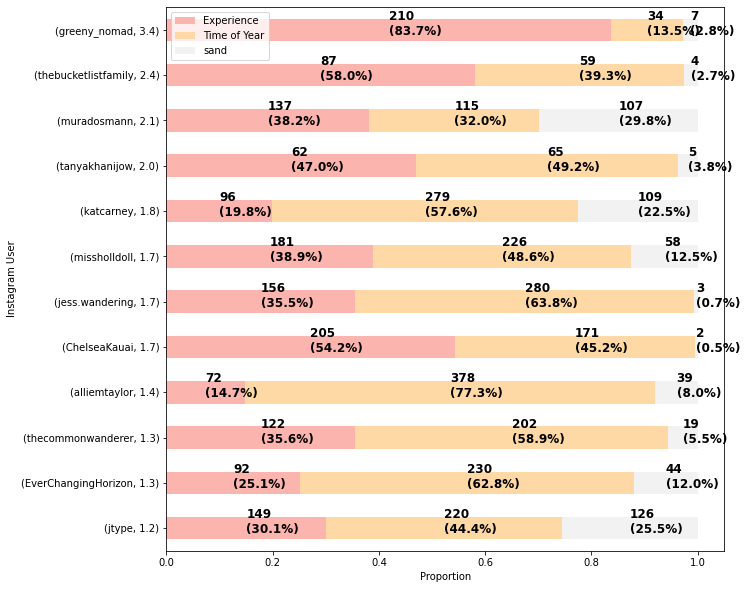

In [ ]:

cross_tab_prop.plot(kind='barh', 
                        stacked=True, 
                        colormap='Pastel1', 
                        figsize=(10, 10))

plt.legend()
plt.ylabel("Instagram User")
plt.xlabel("Proportion")


for n, x in enumerate([*cross_tab.index.values]):
    for (proportion, count, y_loc) in zip(cross_tab_prop.loc[x],
                                          cross_tab.loc[x],
                                          cross_tab_prop.loc[x].cumsum()):
                
        plt.text(x=(y_loc - proportion) + (proportion / 2),
                 y=n - 0.11,
                 s=f'{count}\n({np.round(proportion * 100, 1)}%)', 
                 color="black",
                 fontsize=12,
                 fontweight="bold")

plt.show()

In [ ]:
dataframe31= pd.read_csv('/Users/amritangshumukherjee/Downloads/MIS 284N - Unstructured data/Group Project/data_transfer2.csv')
#dataframe31=dataframe3.set_index('Unnamed: 0')
dataframe31=dataframe31[['posts_with_people','posts_with_mountains','posts_with_captn_attribute','posts_with_all','spacy_similarity_caption','spacy_similarity_image_label']]

In [ ]:
processing_1

,user,bio,followed_by,follows,photo_description,photo_location,likes_photo,comments_photo,image,image_labels,...,comment_3,final,image_labels_token,image_labels_token_final,vader_scores,vader_compound,vader_comp_score,Topic_key,Topic_key_image_labels,Engagement_Score
Unnamed: 0,,,,,,,,,,,,,,,,,,,,,
0,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,I was 6.5 months pregnant on my last winter ad...,NaN,357,16,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Snow,Sunglasses,Freezing,Slope,Eyewear,Geolog...",...,"['thankful', 'was', 'move', 'be', 'seems', 'po...","['thankful', 'move', 'seems', 'portion', 'comf...","[',', 'Snow', 'phenomenon', 'Freezing', 'Eyewe...","[',', 'Snow', 'phenomenon', 'Freezing', 'Eyewe...","{'neg': 0.05, 'neu': 0.667, 'pos': 0.283, 'com...",0.9876,pos,Time of Year,water,0.592535
1,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,Check out the full write up with a ton more ph...,NaN,522,21,https://scontent-dfw5-2.cdninstagram.com/v/t51...,",Water,Water resources,Snow,Natural landscape,...",...,"['recent', 'ice', 'made', 'most', 'link', 'ala...","['recent', 'ice', 'made', 'link', 'alaska', 'c...","['Lake', 'landscape', ',', 'Snow', 'ice', 'Fre...","['Lake', 'landscape', ',', 'Snow', 'ice', 'Fre...","{'neg': 0.0, 'neu': 0.948, 'pos': 0.052, 'comp...",0.3774,pos,Time of Year,water,0.860809
2,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,Yesterday we explored the Matanuska Glacier wi...,NaN,277,16,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Water,Slope,Snow,Terrain,Sports equipment,Rec...",...,"['matanuska', '’', 're', 'their', 'much', 'bec...","['matanuska', '’', 'much', 'ice', 'us', 'big',...","['equipment', 'Terrain', ',', 'Snow', 'phenome...","['equipment', 'Terrain', ',', 'Snow', 'phenome...","{'neg': 0.0, 'neu': 0.851, 'pos': 0.149, 'comp...",0.9041,pos,Time of Year,water,0.468118
3,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,Flying in between the most intense and amazing...,NaN,846,29,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Cloud,Sky,Mountain,Snow,Slope,Glacial landfor...",...,"['ve', '’', 'peaks', 'but', 'ever', 'land', 'r...","['’', 'peaks', 'ever', 'land', 'recommend', 'a...","['Tree', 'Travel', ',', 'Snow', 'Landscape', '...","['Tree', 'Travel', ',', 'Snow', 'Landscape', '...","{'neg': 0.042, 'neu': 0.845, 'pos': 0.113, 'co...",0.4262,pos,Time of Year,water,1.383359
4,katcarney,Outdoor lifestyle commercial & editorial photo...,25720,1651,"It’s been 12 years since we’ve been to Alaska,...",NaN,309,14,https://scontent-dfw5-2.cdninstagram.com/v/t51...,",Mountain,Sky,Cloud,Window,Slope,House,Natural...",...,"['while', 'years', 've', 'we', 'come', 'most',...","['years', 'come', 'place', 'covid', 'taken', '...","['Fog', 'landscape', 'Natural', 'House', 'Wood...","['Fog', 'landscape', 'Natural', 'House', 'Wood...","{'neg': 0.022, 'neu': 0.828, 'pos': 0.15, 'com...",0.9558,pos,Time of Year,sky,0.513219
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8749,laurenepbath,🎤 Speaker 👩🏼‍💻 Coach 📸 Photographer \nAustrali...,383363,2424,Today started well and ended flat. Despite all...,NaN,561,35,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Cloud,Sky,Atmosphere,Afterglow,Orange,Dusk,Su...",...,"[other, today, dropped, ve, scrolling, notice,...","[today, dropped, scrolling, notice, much, suns...","[at, Red, sky, ,, Atmosphere, Afterglow, Dusk,...","[Red, sky, ,, Atmosphere, Afterglow, Dusk, Sun...","{'neg': 0.119, 'neu': 0.791, 'pos': 0.09, 'com...",-0.8151,neg,Experience,water,0.064012
8750,laurenepbath,🎤 Speaker 👩🏼‍💻 Coach 📸 Photographer \nAustrali...,383363,2424,Do you want to know the one main practice I ha...,NaN,327,8,https://scontent-dfw5-1.cdninstagram.com/v/t51...,",Water,Water resources,Green,Plant,Natural lan...",...,"[at, years, lauren, we, from, think, for, alwa...","[years, lauren, think, always, trip, unrelated...","[streams, environment

In [ ]:
processing_11=processing_1.merge(dataframe31, left_index=True, right_index=True)

In [ ]:
processing_11.to_csv('/Users/amritangshumukherjee/Downloads/MIS 284N - Unstructured data/Group Project/data_transfer3.csv')